In [1]:
import pandas as pd
import matplotlib.pyplot as plt

In [2]:
import numpy as np

file_path = "processed_data/data.npy"

try:
    data = np.load(file_path)
    print(f"Data Shape: {data.shape}")
    print(f"Data Type: {data.dtype}")
    print(data[:10])
except Exception as e:
    print(f"Error loading .npy file: {e}")


Data Shape: (28, 132)
Data Type: float64
[[2.85064791e-03 1.23175407e-03 2.33097295e+00 ... 2.06660327e+00
  3.99416369e+00 5.81938591e+00]
 [4.93446309e-03 5.41866739e-02 2.25142783e+00 ... 4.03435940e+00
  4.72128318e+00 3.99931792e+00]
 [5.79890235e-03 3.39569827e-02 2.47000759e+00 ... 4.87414319e+00
  3.50193009e+00 5.63841910e-01]
 ...
 [3.58026909e-03 4.75115459e-03 2.71230349e+00 ... 1.99762486e+00
  1.10050409e+01 1.29013687e+01]
 [3.25114949e-03 3.29254762e-03 1.59768493e+00 ... 5.65933787e+00
  6.35267274e+00 6.43606693e+00]
 [5.88764560e-03 1.11353590e-01 2.28063863e+00 ... 4.41705874e+00
  7.28911129e+00 2.89980164e+00]]


In [5]:
file_path = "processed_data/labels.npy"

try:
    data = np.load(file_path, allow_pickle=True)
    print(f"Data Shape: {data.shape}")
    print(f"Data Type: {data.dtype}")
    print(data[:10])
except Exception as e:
    print(f"Error loading .npy file: {e}")


Data Shape: (28,)
Data Type: object
['N' 'N' 'N' 'N' 'N' 'N' 'N' 'N' 'N' 'N']


In [7]:
import pandas as pd

file_path = "MIT-BIH Arrhythmia Database.csv"
mit_bih_data = pd.read_csv(file_path)

mit_bih_data.head()


,record,type,0_pre-RR,0_post-RR,0_pPeak,0_tPeak,0_rPeak,0_sPeak,0_qPeak,0_qrs_interval,...,1_qPeak,1_qrs_interval,1_pq_interval,1_qt_interval,1_st_interval,1_qrs_morph0,1_qrs_morph1,1_qrs_morph2,1_qrs_morph3,1_qrs_morph4
0,101,N,76,313.0,0.074347,-0.160548,1.036401,-0.285662,-0.026824,41,...,0.025930,2,18,22,2,0.025930,0.025930,0.025930,0.025436,0.025436
1,101,N,313,315.0,-0.052079,-0.264784,0.886597,-0.366298,-0.059710,21,...,-0.042009,26,27,62,9,-0.042009,-0.029498,0.005012,0.030892,0.002986
2,101,N,315,321.0,-0.062151,-0.296983,0.991859,-0.410306,-0.065686,22,...,0.009528,3,8,12,1,0.009528,0.009528,0.008786,0.008786,0.008368
3,101,N,321,336.0,-0.063322,-0.281386,1.034903,-0.403880,-0.071750,22,...,-0.020536,6,9,16,1,-0.020536,-0.020257,-0.018965,-0.016968,-0.014555
4,101,N,336,344.0,-0.062915,1.046914,1.046408,1.046408,-0.074639,11,...,0.016053,16,5,31,10,0.016053,0.006742,0.002782,-0.007798,-0.051155


## 1. Grid Initialization

- Define a 2D grid where each cell corresponds to a region of the heart tissue.
- Each cell is assigned a state `S(i, j, t)` at time step `t`, representing its electrophysiological condition, such as:
  - **0 (Resting):** The cell is at its baseline state.
  - **1 (Excited):** The cell is actively depolarizing due to electrical stimulation.
  - **2 (Refractory):** The cell is recovering and cannot be excited.
- Set boundary conditions to control how the edges of the grid behave (e.g., periodic or fixed).
- Define an initial configuration of the grid, such as:
  - Randomized initial states to simulate spontaneous arrhythmia.
  - Predefined activation patterns to study specific arrhythmic events.

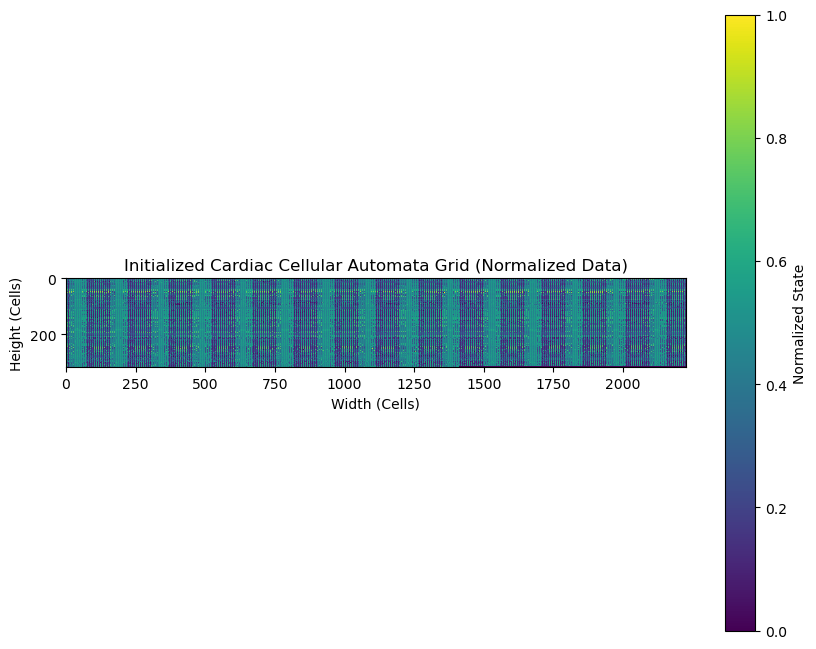

In [10]:
features_to_use = [
    "0_pre-RR", "0_post-RR", "0_pPeak", "0_tPeak", "0_rPeak", "0_sPeak", "0_qPeak"
]

selected_data = mit_bih_data[features_to_use]
normalized_data = (selected_data - selected_data.min()) / (selected_data.max() - selected_data.min())

grid_size = int(np.ceil(np.sqrt(len(normalized_data))))
grid = np.zeros((grid_size, grid_size * len(features_to_use)))

for idx, row in enumerate(normalized_data.values):
    grid[idx // grid_size, (idx % grid_size) * len(features_to_use):(idx % grid_size + 1) * len(features_to_use)] = row

plt.figure(figsize=(10, 8))
plt.title("Initialized Cardiac Cellular Automata Grid (Normalized Data)")
plt.imshow(grid, cmap='viridis', interpolation='nearest')
plt.colorbar(label='Normalized State')
plt.xlabel("Width (Cells)")
plt.ylabel("Height (Cells)")
plt.show()

### 2. Definition of Transition Rules

- Transition rules govern how each cell's state evolves over time based on its neighbors.
- The state at the next time step, \( S(i, j, t+1) \), is determined by:
  \[
  S(i, j, t+1) = f(S(i, j, t), N(i, j, t)),
  \]
  where \( N(i, j, t) \) represents the states of the neighboring cells.
- For arrhythmia modeling, the following rules were used:
  - **Resting to Excited:** A resting cell transitions to excited if one or more neighbors are excited:
    \[
    S(i, j, t+1) = 1 \quad \text{if} \quad \sum_{k \in N(i,j)} S(k, t) \geq \text{Threshold}.
    \]
  - **Excited to Refractory:** An excited cell transitions to the refractory state after a fixed duration.
  - **Refractory to Resting:** A refractory cell transitions back to the resting state after completing its recovery period.
- Rules were calibrated to reflect realistic cardiac electrophysiology, such as action potential duration and conduction velocity.

### 3. Iterative Evolution

- The model evolves over a specified number of time steps, with updates applied simultaneously to all cells.
- At each time step:
  - Apply the transition rules to compute the next state of each cell.
  - Update the grid with the new states.
  - Record the state of the system for visualization and analysis.
- The total number of steps was chosen to capture key arrhythmic dynamics, such as the formation and resolution of spiral waves.



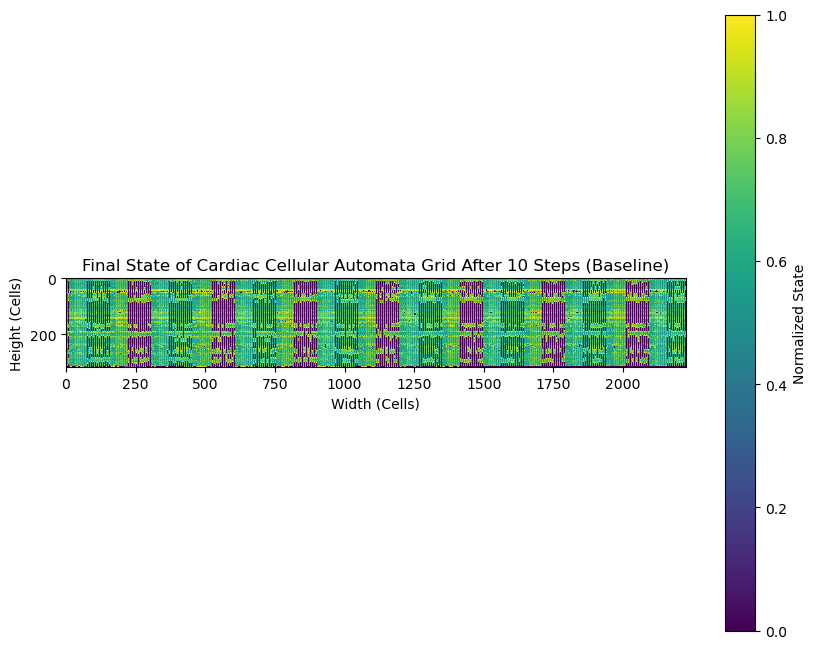

In [13]:
def baseline_transition_rules(grid, i, j, threshold=0.4, recovery_rate=0.05):
    """
    Update the state of a single cell based on baseline rules for normal propagation.
    """
    # Define the neighborhood (Moore neighborhood: 8 neighbors)
    neighbors = [
        grid[i + di, j + dj]
        for di, dj in [(-1, -1), (-1, 0), (-1, 1), (0, -1), (0, 1), (1, -1), (1, 0), (1, 1)]
        if 0 <= i + di < grid.shape[0] and 0 <= j + dj < grid.shape[1]
    ]
    
    neighbor_influence = np.mean(neighbors)
    
    if grid[i, j] > threshold:
        return max(grid[i, j] - recovery_rate, 0)
    elif neighbor_influence > threshold:
        return 1.0
    else:
        return max(grid[i, j] - recovery_rate, 0)

def simulate_baseline(grid, steps):
    """
    Simulate the grid over a specified number of steps under baseline conditions.
    """
    simulation = [grid.copy()]
    for _ in range(steps):
        new_grid = np.zeros_like(grid)
        for i in range(grid.shape[0]):
            for j in range(grid.shape[1]):
                new_grid[i, j] = baseline_transition_rules(grid, i, j)
        simulation.append(new_grid)
        grid = new_grid
    return simulation


steps = 10
baseline_simulation = simulate_baseline(grid, steps)


plt.figure(figsize=(10, 8))
plt.title(f"Final State of Cardiac Cellular Automata Grid After {steps} Steps (Baseline)")
plt.imshow(baseline_simulation[-1], cmap='viridis', interpolation='nearest')
plt.colorbar(label='Normalized State')
plt.xlabel("Width (Cells)")
plt.ylabel("Height (Cells)")
plt.show()


A baseline simulation for arrhythmia modeling was conducted with the following parameters:
- **Grid size:** \( 100 \times 100 \) cells.
- **Number of steps:** 5 time steps.
- **Initial state:** Randomized distribution of excited and resting cells.

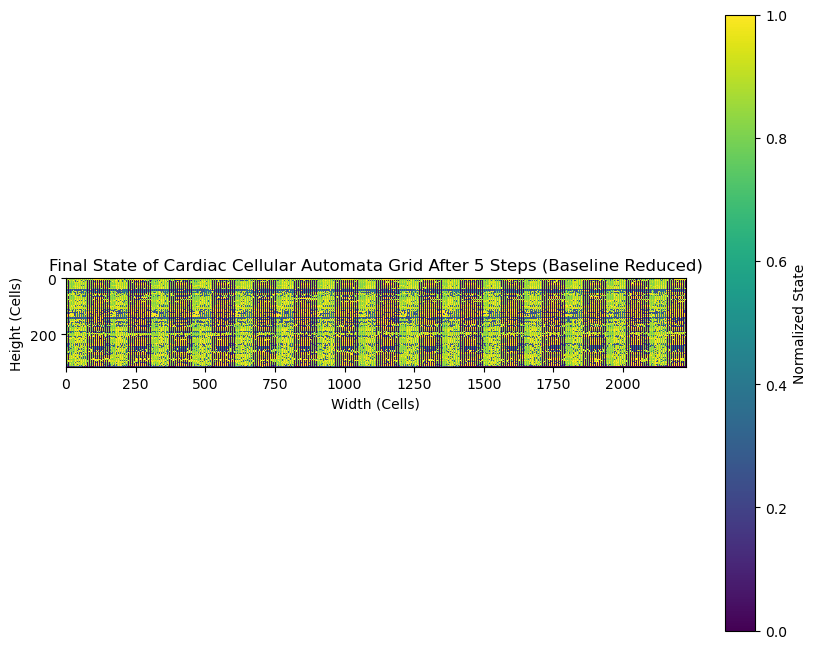

In [15]:
# Redefining simulation with fewer steps for clearer understanding
steps_reduced = 5

# Redefine baseline simulation using fewer steps
def simulate_baseline_reduced(grid, steps):
    """
    Simulate the grid over a specified number of steps under baseline conditions.
    """
    simulation = [grid.copy()]
    for _ in range(steps):
        new_grid = np.zeros_like(grid)
        for i in range(grid.shape[0]):
            for j in range(grid.shape[1]):
                new_grid[i, j] = baseline_transition_rules(grid, i, j)
        simulation.append(new_grid)
        grid = new_grid
    return simulation

# Simulate for reduced steps
baseline_simulation_reduced = simulate_baseline_reduced(grid, steps_reduced)

# Visualize the final state of the grid after reduced baseline simulation
plt.figure(figsize=(10, 8))
plt.title(f"Final State of Cardiac Cellular Automata Grid After {steps_reduced} Steps (Baseline Reduced)")
plt.imshow(baseline_simulation_reduced[-1], cmap='viridis', interpolation='nearest')
plt.colorbar(label='Normalized State')
plt.xlabel("Width (Cells)")
plt.ylabel("Height (Cells)")
plt.show()


In [26]:
# Define the drug effects
drug_effects = {
    'excitation_threshold': 0.6,  # Increased threshold for excitation
    'recovery_rate': 0.03,       # Faster recovery
}

In [28]:
def drug_transition_rules(grid, i, j, drug_effects):
    """
    Update the state of a single cell based on drug-modified rules.
    """
    threshold = drug_effects.get('excitation_threshold', 0.4)
    recovery_rate = drug_effects.get('recovery_rate', 0.05)
    
    # Define the neighborhood (Moore neighborhood: 8 neighbors)
    neighbors = [
        grid[i + di, j + dj]
        for di, dj in [(-1, -1), (-1, 0), (-1, 1), (0, -1), (0, 1), (1, -1), (1, 0), (1, 1)]
        if 0 <= i + di < grid.shape[0] and 0 <= j + dj < grid.shape[1]
    ]
    
    neighbor_influence = np.mean(neighbors)
    
    if grid[i, j] > threshold:
        # Recovery phase
        return max(grid[i, j] - recovery_rate, 0)
    elif neighbor_influence > threshold:
        # Trigger excitation
        return 1.0
    else:
        # Decay in resting state
        return max(grid[i, j] - recovery_rate, 0)

In [30]:
def simulate_with_drug(grid, steps, drug_effects):
    """
    Simulate the grid over a specified number of steps with drug-modified rules.
    """
    simulation = [grid.copy()]
    for _ in range(steps):
        new_grid = np.zeros_like(grid)
        for i in range(grid.shape[0]):
            for j in range(grid.shape[1]):
                new_grid[i, j] = drug_transition_rules(grid, i, j, drug_effects)
        simulation.append(new_grid)
        grid = new_grid
    return simulation

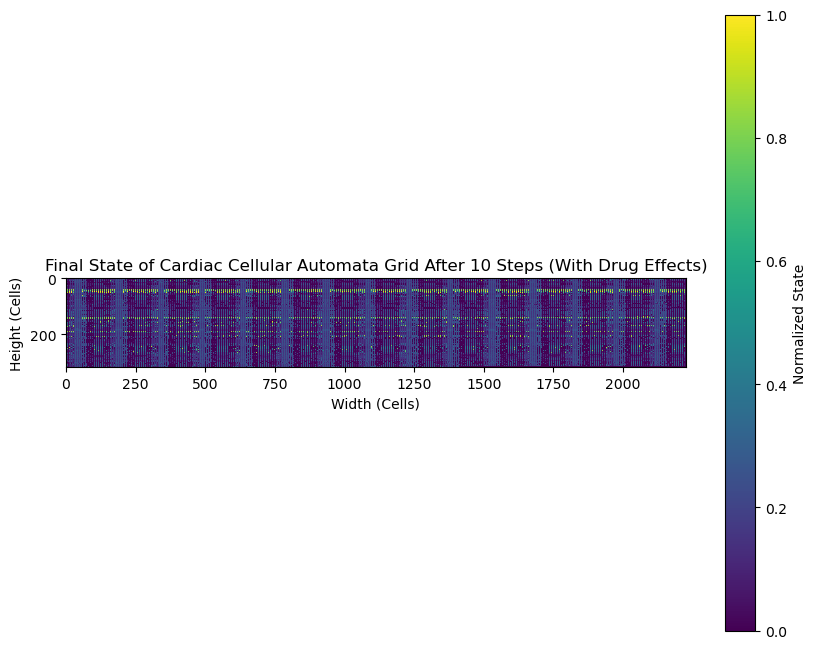

In [32]:
# Simulate with drug effects
steps = 10
drug_simulation = simulate_with_drug(grid, steps, drug_effects)

# Visualize the final state of the grid after drug-effect simulation
plt.figure(figsize=(10, 8))
plt.title(f"Final State of Cardiac Cellular Automata Grid After {steps} Steps (With Drug Effects)")
plt.imshow(drug_simulation[-1], cmap='viridis', interpolation='nearest')
plt.colorbar(label='Normalized State')
plt.xlabel("Width (Cells)")
plt.ylabel("Height (Cells)")
plt.show()

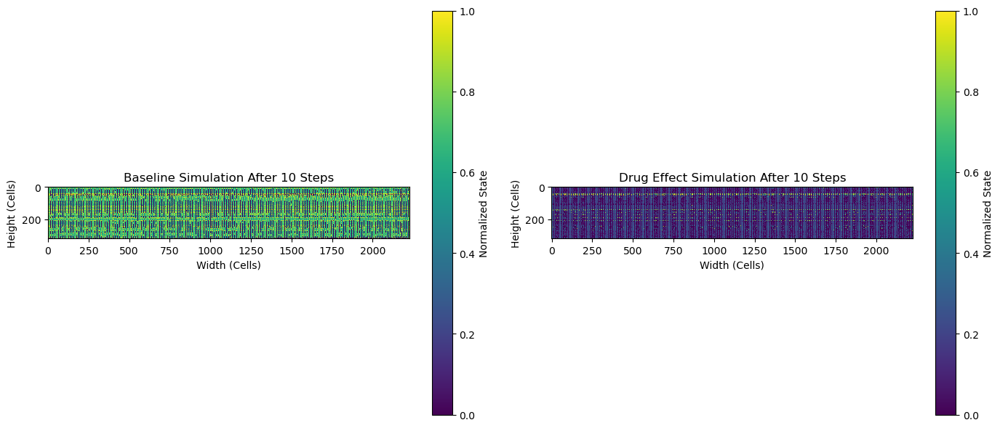

In [34]:
# Visualize baseline vs. drug-effect final states
plt.figure(figsize=(14, 6))

# Baseline
plt.subplot(1, 2, 1)
plt.title(f"Baseline Simulation After {steps} Steps")
plt.imshow(baseline_simulation[-1], cmap='viridis', interpolation='nearest')
plt.colorbar(label='Normalized State')
plt.xlabel("Width (Cells)")
plt.ylabel("Height (Cells)")

# Drug Effect
plt.subplot(1, 2, 2)
plt.title(f"Drug Effect Simulation After {steps} Steps")
plt.imshow(drug_simulation[-1], cmap='viridis', interpolation='nearest')
plt.colorbar(label='Normalized State')
plt.xlabel("Width (Cells)")
plt.ylabel("Height (Cells)")

plt.tight_layout()
plt.show()

## Verification and validation

In [71]:
import unittest
import numpy as np

class TestCellularAutomata(unittest.TestCase):
    def test_grid_initialization(self):
        grid = np.zeros((5, 5))
        self.assertEqual(grid.shape, (5, 5))  # Check grid size
        self.assertTrue((grid == 0).all())    # Ensure all cells are initialized to 0
    
    def test_baseline_transition_rules(self):
        grid = np.array([
            [0.1, 0.5],
            [0.4, 0.6]  # Neighbor influence > threshold
        ])
        result = baseline_transition_rules(grid, 0, 1)
        print(f"Test Result: {result}")
        self.assertAlmostEqual(result, 0.45, places=2)  # Check excitation threshold

    
    def test_drug_transition_rules(self):
        grid = np.array([[0.1, 0.5], [0.2, 0.6]])
        drug_effects = {'excitation_threshold': 0.7, 'recovery_rate': 0.03}
        result = drug_transition_rules(grid, 1, 1, drug_effects)
        self.assertAlmostEqual(result, 0.57, places=2)  # Expected recovery

unittest.main(argv=[''], verbosity=2, exit=False)

test_baseline_transition_rules (__main__.TestCellularAutomata.test_baseline_transition_rules) ... ok
test_drug_transition_rules (__main__.TestCellularAutomata.test_drug_transition_rules) ... ok
test_grid_initialization (__main__.TestCellularAutomata.test_grid_initialization) ... ok

----------------------------------------------------------------------
Ran 3 tests in 0.003s

OK


Cell (0,1) neighbor influence: 0.3666666666666667, current state: 0.5
Test Result: 0.45


In [111]:
def test_grid_initialization_with_normalization():
    data = np.array([[1, 2, 3], [4, 5, 6], [7, 8, 9]])
    normalized = (data - data.min()) / (data.max() - data.min())
    grid_size = int(np.ceil(np.sqrt(len(normalized))))
    grid = np.zeros((grid_size, grid_size))
    for idx, row in enumerate(normalized):
        grid[idx // grid_size, idx % grid_size] = np.mean(row)
    assert grid.shape[0] == grid_size
    assert (grid >= 0).all() and (grid <= 1).all()

def test_baseline_transition_rules_edge_cases():
    grid = np.zeros((5, 5))
    result = baseline_transition_rules(grid, 2, 2)
    assert result == 0  # No neighbors should trigger excitation

    grid = np.ones((5, 5))
    result = baseline_transition_rules(grid, 2, 2)
    assert abs(result - 0.95) < 1e-2  # Recovery rate applied

def test_drug_transition_rules_with_high_threshold():
    grid = np.array([[0.1, 0.5], [0.6, 0.9]])
    drug_effects = {'excitation_threshold': 0.8, 'recovery_rate': 0.1}
    result = drug_transition_rules(grid, 1, 1, drug_effects)
    assert abs(result - 0.8) < 1e-2  # Recovery phase

def test_simulation_stability():
    grid = np.random.rand(5, 5)
    steps = 10
    simulation = simulate_baseline(grid, steps)
    for step in simulation:
        assert (step >= 0).all() and (step <= 1).all()

def test_wave_propagation_speed():
    grid = np.zeros((5, 5))
    grid[2, 2] = 1.0  # Initialize single excited cell
    simulation = simulate_baseline(grid, steps=5)
    propagation_speeds = []
    for t in range(1, len(simulation)):
        delta = np.abs(simulation[t] - simulation[t-1])
        propagation_speeds.append(np.sum(delta))
    assert all(speed >= 0 for speed in propagation_speeds)

def measure_propagation_speed(simulation):
    """
    Measure the average wave propagation speed over all time steps in a simulation.
    """
    propagation_speeds = []
    for t in range(1, len(simulation)):
        delta = np.abs(simulation[t] - simulation[t-1])
        propagation_speeds.append(np.sum(delta))
    return np.mean(propagation_speeds)

def test_baseline_vs_drug_simulation(drug_effects):
    """
    Compare wave propagation speeds between baseline and drug-modified simulations.
    """
    # Generate a random initial grid
    grid = np.random.rand(5, 5)
    
    # Simulate baseline propagation
    baseline_simulation = simulate_baseline(grid, steps=5)
    
    # Simulate drug-modified propagation
    # drug_effects = {'excitation_threshold': 0.6, 'recovery_rate': 0.03}
    drug_simulation = simulate_with_drug(grid, steps=5, drug_effects=drug_effects)
    
    # Measure propagation speeds
    baseline_speed = measure_propagation_speed(baseline_simulation)
    drug_speed = measure_propagation_speed(drug_simulation)
    
    # Log the speeds for debugging
    print(f"Baseline Speed: {baseline_speed}")
    print(f"Drug Speed: {drug_speed}")
    
    # Assert that drug slows propagation
    assert drug_speed < baseline_speed, f"Drug simulation speed {drug_speed} not less than baseline {baseline_speed}"

In [117]:
def run_all_tests():
    drug_effects = {'excitation_threshold': 0.6, 'recovery_rate': 0.03}
    print("Running All Tests...\n")
    tests = [
        ("Test Grid Initialization with Normalization", test_grid_initialization_with_normalization),
        ("Test Baseline Transition Rules Edge Cases", test_baseline_transition_rules_edge_cases),
        ("Test Drug Transition Rules with High Threshold", test_drug_transition_rules_with_high_threshold),
        ("Test Simulation Stability", test_simulation_stability),
        ("Test Wave Propagation Speed", test_wave_propagation_speed),
        ("Test Baseline vs Drug Simulation", lambda: test_baseline_vs_drug_simulation(drug_effects))
    ]

    for test_name, test_function in tests:
        try:
            print(f"Running {test_name}...")
            test_function()  # Call the test function
            print(f"{test_name}: PASSED\n")
        except AssertionError as e:
            print(f"{test_name}: FAILED with AssertionError - {e}\n")
        except Exception as e:
            print(f"{test_name}: FAILED with Exception - {e}\n")

    print("All Tests Completed.")

In [119]:
if __name__ == "__main__":
    # Call the function to run all tests
    run_all_tests()

Running All Tests...

Running Test Grid Initialization with Normalization...
Test Grid Initialization with Normalization: PASSED

Running Test Baseline Transition Rules Edge Cases...
Cell (2,2) neighbor influence: 0.0, current state: 0.0
Cell (2,2) neighbor influence: 1.0, current state: 1.0
Test Baseline Transition Rules Edge Cases: PASSED

Running Test Drug Transition Rules with High Threshold...
Test Drug Transition Rules with High Threshold: PASSED

Running Test Simulation Stability...
Cell (0,0) neighbor influence: 0.3641746956043246, current state: 0.5361773240564047
Cell (0,1) neighbor influence: 0.5130360486164496, current state: 0.22249348498977606
Cell (0,2) neighbor influence: 0.2682074124633118, current state: 0.6980362672655691
Cell (0,3) neighbor influence: 0.610268199297898, current state: 0.27692393379000146
Cell (0,4) neighbor influence: 0.4847645734037891, current state: 0.7149988928654787
Cell (1,0) neighbor influence: 0.4416290231010658, current state: 0.72371712513

In [134]:
from sklearn.model_selection import KFold

def test_cross_validation():
    """
    Perform cross-validation to assess the propagation speed consistency across splits.
    """
    print("Running Test Cross Validation...")
    kf = KFold(n_splits=5, shuffle=True, random_state=42)
    propagation_speeds = []
    for fold, (train_index, test_index) in enumerate(kf.split(normalized_data)):
        train_data, test_data = normalized_data.iloc[train_index], normalized_data.iloc[test_index]
        grid_size = int(np.ceil(np.sqrt(len(train_data))))
        grid = np.zeros((grid_size, grid_size))

        # Initialize the grid using training data
        for idx, row in enumerate(train_data.values):
            grid[idx // grid_size, idx % grid_size] = np.mean(row)

        # Run baseline simulation
        simulation = simulate_baseline(grid, steps=10)
        speed = measure_propagation_speed(simulation)
        propagation_speeds.append(speed)
        print(f"Fold {fold + 1}: Propagation Speed = {speed}")

    avg_speed = np.mean(propagation_speeds)
    print(f"Cross-validated Propagation Speeds: {propagation_speeds}")
    print(f"Average Propagation Speed: {avg_speed}\n")

def run_all_tests_with_cross_validation():
    drug_effects = {'excitation_threshold': 0.6, 'recovery_rate': 0.03}
    print("Running All Tests...\n")
    tests = [
        ("Test Grid Initialization with Normalization", test_grid_initialization_with_normalization),
        ("Test Baseline Transition Rules Edge Cases", test_baseline_transition_rules_edge_cases),
        ("Test Drug Transition Rules with High Threshold", test_drug_transition_rules_with_high_threshold),
        ("Test Simulation Stability", test_simulation_stability),
        ("Test Wave Propagation Speed", test_wave_propagation_speed),
        ("Test Baseline vs Drug Simulation", lambda: test_baseline_vs_drug_simulation(drug_effects)),
        ("Test Cross Validation", test_cross_validation)  # Add cross-validation as a separate test
    ]

    for test_name, test_function in tests:
        try:
            print(f"Running {test_name}...")
            test_function()  # Call the test function
            print(f"{test_name}: PASSED\n")
        except AssertionError as e:
            print(f"{test_name}: FAILED with AssertionError - {e}\n")
        except Exception as e:
            print(f"{test_name}: FAILED with Exception - {e}\n")

    print("All Tests Completed.")

In [136]:
if __name__ == "__main__":
    run_all_tests_with_cross_validation()

Running All Tests...

Running Test Grid Initialization with Normalization...
Test Grid Initialization with Normalization: PASSED

Running Test Baseline Transition Rules Edge Cases...
Cell (2,2) neighbor influence: 0.0, current state: 0.0
Cell (2,2) neighbor influence: 1.0, current state: 1.0
Test Baseline Transition Rules Edge Cases: PASSED

Running Test Drug Transition Rules with High Threshold...
Test Drug Transition Rules with High Threshold: PASSED

Running Test Simulation Stability...
Cell (0,0) neighbor influence: 0.34912530792484936, current state: 0.22224011697102086
Cell (0,1) neighbor influence: 0.35846352049606833, current state: 0.43642966803088656
Cell (0,2) neighbor influence: 0.5287200124032979, current state: 0.2362264527146528
Cell (0,3) neighbor influence: 0.43879939472221385, current state: 0.04035570514180675
Cell (0,4) neighbor influence: 0.40155882721343045, current state: 0.07054496734692617
Cell (1,0) neighbor influence: 0.28385643468087396, current state: 0.147

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



Cell (96,217) neighbor influence: 0.17650144120451017, current state: 0.1936047337944758
Cell (96,218) neighbor influence: 0.1770766901892917, current state: 0.1908955293198123
Cell (96,219) neighbor influence: 0.17630321562169368, current state: 0.18954407319823152
Cell (96,220) neighbor influence: 0.17530629810796616, current state: 0.1895419490185835
Cell (96,221) neighbor influence: 0.17406309985365248, current state: 0.19227413370971463
Cell (96,222) neighbor influence: 0.17484656294786985, current state: 0.1911772429269381
Cell (96,223) neighbor influence: 0.17617889613027338, current state: 0.19329197491639571
Cell (96,224) neighbor influence: 0.17794355937660905, current state: 0.19307878092866942
Cell (96,225) neighbor influence: 0.17708796329151313, current state: 0.19348550807374992
Cell (96,226) neighbor influence: 0.17593500365760842, current state: 0.1911740793466361
Cell (96,227) neighbor influence: 0.17461477861785063, current state: 0.1902945256153351
Cell (96,228) nei

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



Cell (226,96) neighbor influence: 0.8875, current state: 0.8999999999999999
Cell (226,97) neighbor influence: 0.8749999999999999, current state: 0.8499999999999999
Cell (226,98) neighbor influence: 0.8624999999999998, current state: 0.8499999999999999
Cell (226,99) neighbor influence: 0.8687499999999999, current state: 0.8499999999999999
Cell (226,100) neighbor influence: 0.8999999999999999, current state: 0.8999999999999999
Cell (226,101) neighbor influence: 0.7141475719490682, current state: 0.95
Cell (226,102) neighbor influence: 0.50887691385977, current state: 0.05632477311929732
Cell (226,103) neighbor influence: 0.17276657005204044, current state: 0.05615901784807467
Cell (226,104) neighbor influence: 0.053335355317024186, current state: 0.050468552303875175
Cell (226,105) neighbor influence: 0.050835634049874644, current state: 0.054706130450316165
Cell (226,106) neighbor influence: 0.06488370535527498, current state: 0.05079444562872734
Cell (226,107) neighbor influence: 0.066

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



Cell (0,0) neighbor influence: 0.36900158061637905, current state: 0.35131410569817095
Cell (0,1) neighbor influence: 0.3680257556348481, current state: 0.35697475553897784
Cell (0,2) neighbor influence: 0.365305949107558, current state: 0.35796524480178
Cell (0,3) neighbor influence: 0.3599942750268011, current state: 0.36068653462012007
Cell (0,4) neighbor influence: 0.35650297507936607, current state: 0.3575442062147984
Cell (0,5) neighbor influence: 0.36085373657322756, current state: 0.3610973111189916
Cell (0,6) neighbor influence: 0.36487101673579386, current state: 0.35927419061007815
Cell (0,7) neighbor influence: 0.3663788486999791, current state: 0.35949780832663214
Cell (0,8) neighbor influence: 0.36447964271622846, current state: 0.3593886901839281
Cell (0,9) neighbor influence: 0.3643151170769764, current state: 0.36064432708065397
Cell (0,10) neighbor influence: 0.36653611312489753, current state: 0.3572396780325829
Cell (0,11) neighbor influence: 0.3672104412618424, cur

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



Cell (118,166) neighbor influence: 0.2313972701678764, current state: 0.1917376582162595
Cell (118,167) neighbor influence: 0.2243689431943225, current state: 0.189237088501705
Cell (118,168) neighbor influence: 0.22093024403480493, current state: 0.24163803958518576
Cell (118,169) neighbor influence: 0.22960982771345967, current state: 0.1954937699527125
Cell (118,170) neighbor influence: 0.22783542391558448, current state: 0.23769310750103434
Cell (118,171) neighbor influence: 0.22631075001773224, current state: 0.24117626563156136
Cell (118,172) neighbor influence: 0.22999168533779873, current state: 0.24360081883259965
Cell (118,173) neighbor influence: 0.23053226930628126, current state: 0.23209579588267953
Cell (118,174) neighbor influence: 0.24018209237131577, current state: 0.20144638862441983
Cell (118,175) neighbor influence: 0.23589348392260018, current state: 0.23886147387500817
Cell (118,176) neighbor influence: 0.23360642711324087, current state: 0.24579978546725673
Cell 

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



Cell (250,74) neighbor influence: 0.05250537759114842, current state: 0.044144063599300815
Cell (250,75) neighbor influence: 0.05638703400438068, current state: 0.05452379565971996
Cell (250,76) neighbor influence: 0.0536061481487669, current state: 0.06060557594897545
Cell (250,77) neighbor influence: 0.06059858606454447, current state: 0.04559891336809621
Cell (250,78) neighbor influence: 0.06190754931756957, current state: 0.07216518797233476
Cell (250,79) neighbor influence: 0.06140818184199386, current state: 0.0884254028078179
Cell (250,80) neighbor influence: 0.0578309157166102, current state: 0.052809015676071575
Cell (250,81) neighbor influence: 0.05264252608004535, current state: 0.040235537727396825
Cell (250,82) neighbor influence: 0.052578499724973866, current state: 0.049383797869203966
Cell (250,83) neighbor influence: 0.05654047421277352, current state: 0.05435672594366578
Cell (250,84) neighbor influence: 0.05519658911334588, current state: 0.05968471580559878
Cell (25

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



Cell (0,0) neighbor influence: 0.37315083298715307, current state: 0.35697475553897784
Cell (0,1) neighbor influence: 0.3715607646962912, current state: 0.35796524480178
Cell (0,2) neighbor influence: 0.37707402619096797, current state: 0.36068653462012007
Cell (0,3) neighbor influence: 0.36010570055017876, current state: 0.4205489644072385
Cell (0,4) neighbor influence: 0.3678416369648532, current state: 0.3575442062147984
Cell (0,5) neighbor influence: 0.3606507899045469, current state: 0.35792819075930893
Cell (0,6) neighbor influence: 0.36455709322232915, current state: 0.35825945726667446
Cell (0,7) neighbor influence: 0.36619772565983916, current state: 0.3610973111189916
Cell (0,8) neighbor influence: 0.364484697501206, current state: 0.35949780832663214
Cell (0,9) neighbor influence: 0.36433694070551725, current state: 0.35907009821318214
Cell (0,10) neighbor influence: 0.36622126735140315, current state: 0.3572396780325829
Cell (0,11) neighbor influence: 0.3672104412618424, cu

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



Cell (120,197) neighbor influence: 0.5208177610010734, current state: 0.19531220705646085
Cell (120,198) neighbor influence: 0.5125715497501685, current state: 0.19580632156045935
Cell (120,199) neighbor influence: 0.5147223593531046, current state: 0.1964568632293352
Cell (120,200) neighbor influence: 0.5137323210248016, current state: 0.2307282167722029
Cell (120,201) neighbor influence: 0.5221036974400897, current state: 0.22751428021029874
Cell (120,202) neighbor influence: 0.5168862272324977, current state: 0.24150167430346847
Cell (120,203) neighbor influence: 0.5110455894524799, current state: 0.19279427504062652
Cell (120,204) neighbor influence: 0.5118212165294252, current state: 0.17874773714830766
Cell (120,205) neighbor influence: 0.4981714383035456, current state: 0.23754885456903013
Cell (120,206) neighbor influence: 0.5182080323413498, current state: 0.19514487878623887
Cell (120,207) neighbor influence: 0.5080434045033213, current state: 0.24269292081281857
Cell (120,20

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



Cell (193,151) neighbor influence: 0.40610961302110704, current state: 0.06168429285999208
Cell (193,152) neighbor influence: 0.4021808813349528, current state: 0.046226972123878524
Cell (193,153) neighbor influence: 0.3935825756580968, current state: 0.1010269054353206
Cell (193,154) neighbor influence: 0.3929695071784727, current state: 0.053387506220577946
Cell (193,155) neighbor influence: 0.28860389754682203, current state: 0.0
Cell (193,156) neighbor influence: 0.16289021692704508, current state: 0.11238817087845925
Cell (193,157) neighbor influence: 0.04871081614485963, current state: 0.0
Cell (193,158) neighbor influence: 0.042228628819687475, current state: 0.02650169898416635
Cell (193,159) neighbor influence: 0.027895381864699052, current state: 0.0340184548067238
Cell (193,160) neighbor influence: 0.029781382463542297, current state: 0.0
Cell (193,161) neighbor influence: 0.02169356223721531, current state: 0.05257221362426026
Cell (193,162) neighbor influence: 0.0490681426

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



Cell (260,211) neighbor influence: 0.6999999999999997, current state: 0.6999999999999997
Cell (260,212) neighbor influence: 0.7312499999999997, current state: 0.7499999999999998
Cell (260,213) neighbor influence: 0.7499999999999998, current state: 0.7499999999999998
Cell (260,214) neighbor influence: 0.7374999999999998, current state: 0.7499999999999998
Cell (260,215) neighbor influence: 0.7124999999999997, current state: 0.6999999999999997
Cell (260,216) neighbor influence: 0.6812499999999997, current state: 0.6499999999999997
Cell (260,217) neighbor influence: 0.6624999999999998, current state: 0.6499999999999997
Cell (260,218) neighbor influence: 0.6812499999999997, current state: 0.6499999999999997
Cell (260,219) neighbor influence: 0.7187499999999998, current state: 0.6999999999999997
Cell (260,220) neighbor influence: 0.7812499999999998, current state: 0.7499999999999998
Cell (260,221) neighbor influence: 0.8187499999999999, current state: 0.8499999999999999
Cell (260,222) neighb

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



Cell (129,183) neighbor influence: 0.4368302016665506, current state: 0.297976039870395
Cell (129,184) neighbor influence: 0.4363327316044085, current state: 0.29656547970494673
Cell (129,185) neighbor influence: 0.5209399817634062, current state: 0.29728492262597384
Cell (129,186) neighbor influence: 0.5329723096729294, current state: 0.29896908924375726
Cell (129,187) neighbor influence: 0.5331202219085636, current state: 0.2955917016570312
Cell (129,188) neighbor influence: 0.5320562784139744, current state: 0.29598275769537824
Cell (129,189) neighbor influence: 0.5209528332632948, current state: 0.29287673143343956
Cell (129,190) neighbor influence: 0.5209666303968352, current state: 0.2926876182339851
Cell (129,191) neighbor influence: 0.5214472262015092, current state: 0.29636412655592725
Cell (129,192) neighbor influence: 0.5217401241832288, current state: 0.2968627571006941
Cell (129,193) neighbor influence: 0.5221232695747335, current state: 0.2970548389105406
Cell (129,194) n

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



Cell (11,227) neighbor influence: 0.5642659291583412, current state: 0.95
Cell (11,228) neighbor influence: 0.7499999999999999, current state: 0.8499999999999999
Cell (11,229) neighbor influence: 0.8249999999999998, current state: 0.7999999999999998
Cell (11,230) neighbor influence: 0.7999999999999998, current state: 0.7999999999999998
Cell (11,231) neighbor influence: 0.7999999999999998, current state: 0.7999999999999998
Cell (11,232) neighbor influence: 0.7999999999999998, current state: 0.7999999999999998
Cell (11,233) neighbor influence: 0.8062499999999999, current state: 0.7999999999999998
Cell (11,234) neighbor influence: 0.8062499999999999, current state: 0.7999999999999998
Cell (11,235) neighbor influence: 0.8062499999999999, current state: 0.7999999999999998
Cell (11,236) neighbor influence: 0.7999999999999998, current state: 0.7999999999999998
Cell (11,237) neighbor influence: 0.8062499999999999, current state: 0.7999999999999998
Cell (11,238) neighbor influence: 0.8062499999

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



Cell (67,105) neighbor influence: 0.39614057592188, current state: 0.39703938845029746
Cell (67,106) neighbor influence: 0.39408164778684707, current state: 0.39699132498506773
Cell (67,107) neighbor influence: 0.39653496335241406, current state: 0.396133553822056
Cell (67,108) neighbor influence: 0.3957046777158373, current state: 0.4009068526203778
Cell (67,109) neighbor influence: 0.3979172931651306, current state: 0.39862775648612664
Cell (67,110) neighbor influence: 0.3972845068381814, current state: 0.39732500111069424
Cell (67,111) neighbor influence: 0.39677429129477276, current state: 0.39910543594164605
Cell (67,112) neighbor influence: 0.3980365591594842, current state: 0.39618406111408344
Cell (67,113) neighbor influence: 0.39780745398214223, current state: 0.3995985811241701
Cell (67,114) neighbor influence: 0.3995441486966756, current state: 0.39572761375246024
Cell (67,115) neighbor influence: 0.39908898057814157, current state: 0.39893697610876994
Cell (67,116) neighbor

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



Cell (193,27) neighbor influence: 0.19318148953219436, current state: 0.1412168975702015
Cell (193,28) neighbor influence: 0.17611717794294693, current state: 0.2630988464994529
Cell (193,29) neighbor influence: 0.2003462604475777, current state: 0.14488630100098104
Cell (193,30) neighbor influence: 0.1786292246273941, current state: 0.26192630820514073
Cell (193,31) neighbor influence: 0.20283574284593808, current state: 0.1460088174481285
Cell (193,32) neighbor influence: 0.17998485141946058, current state: 0.20366378466295193
Cell (193,33) neighbor influence: 0.19705133780455966, current state: 0.14226821250827892
Cell (193,34) neighbor influence: 0.18051705706268564, current state: 0.20511809596458574
Cell (193,35) neighbor influence: 0.21703617188815894, current state: 0.147051384553552
Cell (193,36) neighbor influence: 0.1858541085436962, current state: 0.26410036052385244
Cell (193,37) neighbor influence: 0.18578143819306311, current state: 0.20357855844784628
Cell (193,38) neig

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



Cell (40,78) neighbor influence: 0.7812499999999998, current state: 0.7999999999999998
Cell (40,79) neighbor influence: 0.7749999999999998, current state: 0.7499999999999998
Cell (40,80) neighbor influence: 0.7874999999999999, current state: 0.7499999999999998
Cell (40,81) neighbor influence: 0.7687499999999998, current state: 0.7499999999999998
Cell (40,82) neighbor influence: 0.7687499999999998, current state: 0.7499999999999998
Cell (40,83) neighbor influence: 0.7499999999999998, current state: 0.7499999999999998
Cell (40,84) neighbor influence: 0.7499999999999998, current state: 0.7499999999999998
Cell (40,85) neighbor influence: 0.7749999999999998, current state: 0.7499999999999998
Cell (40,86) neighbor influence: 0.7874999999999999, current state: 0.7999999999999998
Cell (40,87) neighbor influence: 0.7999999999999998, current state: 0.7499999999999998
Cell (40,88) neighbor influence: 0.7812499999999998, current state: 0.7999999999999998
Cell (40,89) neighbor influence: 0.79374999

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)




Cell (173,219) neighbor influence: 0.7562499999999999, current state: 0.7999999999999998
Cell (173,220) neighbor influence: 0.7687499999999998, current state: 0.6999999999999997
Cell (173,221) neighbor influence: 0.7687499999999998, current state: 0.6999999999999997
Cell (173,222) neighbor influence: 0.7562499999999999, current state: 0.7999999999999998
Cell (173,223) neighbor influence: 0.7687499999999998, current state: 0.6999999999999997
Cell (173,224) neighbor influence: 0.7437499999999997, current state: 0.7999999999999998
Cell (173,225) neighbor influence: 0.7312499999999997, current state: 0.7999999999999998
Cell (173,226) neighbor influence: 0.7562499999999998, current state: 0.6999999999999997
Cell (173,227) neighbor influence: 0.7437499999999998, current state: 0.7999999999999998
Cell (173,228) neighbor influence: 0.7687499999999998, current state: 0.6999999999999997
Cell (173,229) neighbor influence: 0.7437499999999997, current state: 0.7999999999999998
Cell (173,230) neigh

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



### Different drug effects

In [121]:
drug_effects_list = [
    {'excitation_threshold': 0.5, 'recovery_rate': 0.02},
    {'excitation_threshold': 0.7, 'recovery_rate': 0.05},
    {'excitation_threshold': 0.9, 'recovery_rate': 0.1},
]
for drug_effects in drug_effects_list:
    test_baseline_vs_drug_simulation(drug_effects)

Cell (0,0) neighbor influence: 0.3051534496745428, current state: 0.7792552786590922
Cell (0,1) neighbor influence: 0.371447601797974, current state: 0.11426667888268915
Cell (0,2) neighbor influence: 0.23564234960789232, current state: 0.006980972270092867
Cell (0,3) neighbor influence: 0.28230298931305037, current state: 0.040205419113155005
Cell (0,4) neighbor influence: 0.3618253899454784, current state: 0.08945513565213303
Cell (1,0) neighbor influence: 0.46076230292729176, current state: 0.4744764858801789
Cell (1,1) neighbor influence: 0.4024621789031726, current state: 0.32671718426076035
Cell (1,2) neighbor influence: 0.33873565639472386, current state: 0.26980808791974564
Cell (1,3) neighbor influence: 0.34627889006007306, current state: 0.42721437786311145
Cell (1,4) neighbor influence: 0.3622525021028048, current state: 0.6180563728601688
Cell (2,0) neighbor influence: 0.5145294427881109, current state: 0.5884438090726358
Cell (2,1) neighbor influence: 0.5058501012321711, c

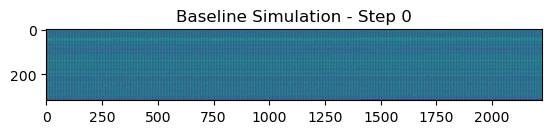

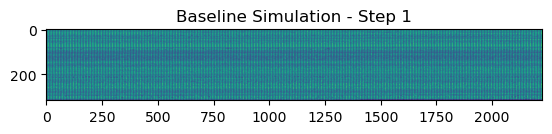

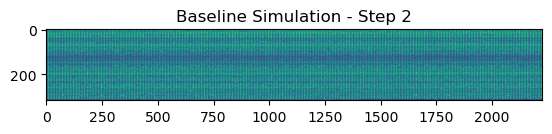

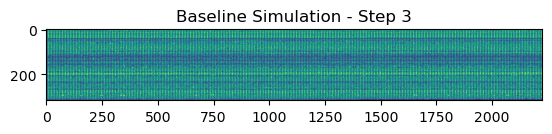

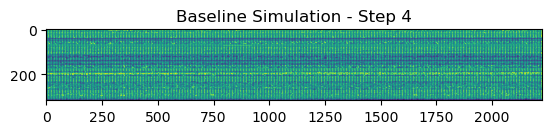

...

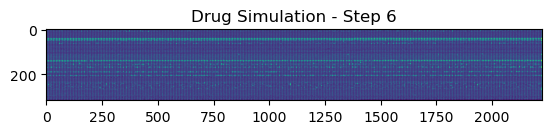

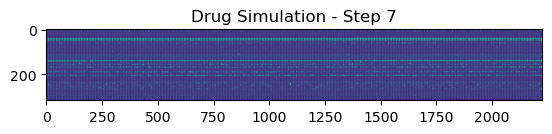

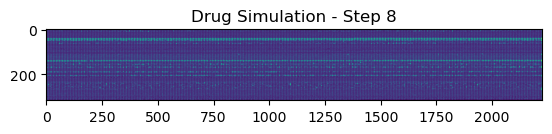

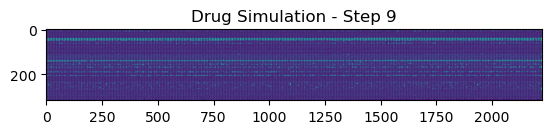

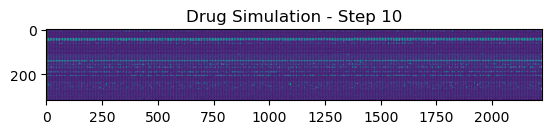

In [123]:
for t, state in enumerate(baseline_simulation):
    plt.imshow(state, cmap='viridis')
    plt.title(f"Baseline Simulation - Step {t}")
    plt.show()

for t, state in enumerate(drug_simulation):
    plt.imshow(state, cmap='viridis')
    plt.title(f"Drug Simulation - Step {t}")
    plt.show()